In [3]:
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
# Parse HTML file using BeautifulSoup
with open("results/tomtom_results/Filters_motifs_filter_pwms.meme_res/tomtom.html") as f:
    soup = BeautifulSoup(f, "html.parser")

In [5]:
import xml.etree.ElementTree as ET

# Replace the file path with the path to your XML file
xml_file = "results/tomtom_results/Filters_motifs_filter_pwms.meme_res/tomtom.xml"
# Replace the file path with the path to your XML file

# Parse the XML file
tree = ET.parse(xml_file)

# Find all the <motif> elements
motif_elements = tree.findall('.//motif')

# Extract the 'id' and 'alt' attributes and print them
rbp_map = {}
for motif in motif_elements:
    motif_id = motif.get('id')
    motif_alt = motif.get('alt')
    if motif_alt:
        rbp_map[motif_id] = motif_alt

rbp_map

{'RNCMPT00001': 'A1CF',
 'RNCMPT00002': 'ANKHD1',
 'RNCMPT00003': 'ARET',
 'RNCMPT00004': 'BRUNOL4',
 'RNCMPT00005': 'TIAR-3',
 'RNCMPT00006': 'CG14718',
 'RNCMPT00007': 'CG2950',
 'RNCMPT00008': 'CNOT4',
 'RNCMPT00009': 'CG33714',
 'RNCMPT00010': 'CG5213',
 'RNCMPT00011': 'PAPI',
 'RNCMPT00012': 'CPEB2',
 'RNCMPT00013': 'DAZAP1',
 'RNCMPT00014': 'EXC-7',
 'RNCMPT00015': 'FMR1',
 'RNCMPT00016': 'FMR1',
 'RNCMPT00017': 'FOX-1',
 'RNCMPT00018': 'FUS',
 'RNCMPT00019': 'SRSF10',
 'RNCMPT00020': 'FXR2',
 'RNCMPT00022': 'HNRNPA1',
 'RNCMPT00023': 'HNRNPA1L2',
 'RNCMPT00024': 'HNRNPA2B1',
 'RNCMPT00025': 'HNRNPC',
 'RNCMPT00026': 'HNRNPK',
 'RNCMPT00027': 'HNRNPL',
 'RNCMPT00028': 'HRB27C',
 'RNCMPT00029': 'HRB87F',
 'RNCMPT00031': 'Hrp1p',
 'RNCMPT00032': 'HuR',
 'RNCMPT00033': 'IGF2BP2',
 'RNCMPT00034': 'KHDRBS3',
 'RNCMPT00035': 'LARK',
 'RNCMPT00036': 'LIN28A',
 'RNCMPT00037': 'MATR3',
 'RNCMPT00038': 'MBNL1',
 'RNCMPT00039': 'MEX-5',
 'RNCMPT00040': 'MSI',
 'RNCMPT00041': 'MSI1',
 'RNCMP

In [61]:

import pandas as pd
filter_rbps = pd.read_csv('results/tomtom_results/Filters_motifs_filter_pwms.meme_res/tomtom.tsv', sep='\t')
# remove nan values
filter_rbps = filter_rbps.dropna()
filter_rbps.head()

,Query_ID,Target_ID,Optimal_offset,p-value,E-value,q-value,Overlap,Query_consensus,Target_consensus,Orientation
0,filter_0,RNCMPT00287,-1.0,0.001799,0.439004,0.439004,7.0,UGACUACU,UACUACG,+
1,filter_0,RNCMPT00073,-1.0,0.008466,2.065820,0.999985,7.0,UGACUACU,GACGACGG,+
2,filter_0,RNCMPT00061,-2.0,0.032716,7.982630,0.999985,6.0,UGACUACU,ACGACGA,+
3,filter_1,RNCMPT00052,1.0,0.002857,0.697075,0.260186,6.0,CGCGGCGG,GCGCGGG,+
4,filter_1,RNCMPT00162,-2.0,0.004025,0.982147,0.260186,6.0,CGCGGCGG,CGGAGGA,+


In [7]:
# # only keep the significant matches in filter_rbps
# filter_rbps = filter_rbps[filter_rbps['q-value'] < 0.1]
# print('number of significant hits: ', filter_rbps.shape[0])

In [8]:
filter_rbps_dict = {}
for index, row in filter_rbps.iterrows():
    if row['Query_ID'] in filter_rbps_dict:
        filter_rbps_dict[row['Query_ID']].append(row['Target_ID'])
    else:
        filter_rbps_dict[row['Query_ID']] = [row['Target_ID']]
filter_rbps_dict

{'filter_0': ['RNCMPT00287', 'RNCMPT00073', 'RNCMPT00061'],
 'filter_1': ['RNCMPT00052',
  'RNCMPT00162',
  'RNCMPT00113',
  'RNCMPT00073',
  'RNCMPT00124',
  'RNCMPT00085',
  'RNCMPT00163',
  'RNCMPT00045',
  'RNCMPT00134',
  'RNCMPT00108',
  'RNCMPT00009'],
 'filter_2': ['RNCMPT00119',
  'RNCMPT00228',
  'RNCMPT00032',
  'RNCMPT00086',
  'RNCMPT00236',
  'RNCMPT00274',
  'RNCMPT00112',
  'RNCMPT00117',
  'RNCMPT00262',
  'RNCMPT00121',
  'RNCMPT00202',
  'RNCMPT00080',
  'RNCMPT00136',
  'RNCMPT00165',
  'RNCMPT00232',
  'RNCMPT00077',
  'RNCMPT00005',
  'RNCMPT00256',
  'RNCMPT00132',
  'RNCMPT00159',
  'RNCMPT00158',
  'RNCMPT00167',
  'RNCMPT00079',
  'RNCMPT00025',
  'RNCMPT00220',
  'RNCMPT00229',
  'RNCMPT00114',
  'RNCMPT00120',
  'RNCMPT00012',
  'RNCMPT00183',
  'RNCMPT00004',
  'RNCMPT00270',
  'RNCMPT00003',
  'RNCMPT00011',
  'RNCMPT00217',
  'RNCMPT00268',
  'RNCMPT00166',
  'RNCMPT00258',
  'RNCMPT00014'],
 'filter_3': ['RNCMPT00046',
  'RNCMPT00206',
  'RNCMPT00101',
 

In [9]:
for key, value in filter_rbps_dict.items():
    filter_rbps_dict[key] = list(set([rbp_map[x] for x in value]))
filter_rbps_dict


{'filter_0': ['RSF1', 'SRSF7', 'An_0287'],
 'filter_1': ['CG33714',
  'RBM4',
  'ZC3H10',
  'PPRC1',
  'LIN28A',
  'SRSF1',
  'LARK',
  'B52',
  'SRSF7'],
 'filter_2': ['Tb_0220',
  'ARET',
  'ZC3H14',
  'BRUNOL4',
  'HNRNPCL1',
  'RBP9',
  'Ot_0262',
  'TIA1',
  'CPEB2',
  'HuR',
  'CPEB4',
  'FNE',
  'Pp_0229',
  'Smp_067420',
  'EXC-7',
  'RALY',
  'Tv_0258',
  'SXL',
  'Tv_0236',
  'PAPI',
  'U2AF2',
  'TIAR-1',
  'PFI1435w',
  'Tb_0217',
  'HNRNPC',
  'ELAV',
  'BRUNOL5',
  'U2AF50',
  'ETR-1',
  'PTBP1',
  'Pp_0228',
  'TIAR-3'],
 'filter_3': ['RBM45',
  'PUM',
  'YBX1',
  'Pp_0206',
  'MAL8P1.40',
  'PF13_0315',
  'Sf3b4',
  'An_0265'],
 'filter_4': ['PABP',
  'RBMS1',
  'MAL13P1.35',
  'Rbm42',
  'Tb_0219',
  'IGF2BP2',
  'IGF2BP3',
  'Tb_0251',
  'RBM41',
  'TUT1'],
 'filter_6': ['UNC-75',
  'ARET',
  'Rbm38',
  'BRUNOL4',
  'BRUNOL6',
  'ZC3H14',
  'TIA1',
  'ORB2',
  'HuR',
  'FNE',
  'RBM38',
  'RALY',
  'Tv_0258',
  'PAPI',
  'PFI1435w',
  'Tb_0217',
  'ELAV',
  'BRU-3',
 

In [10]:
filter_rbps_dict['filter_1']

['CG33714',
 'RBM4',
 'ZC3H10',
 'PPRC1',
 'LIN28A',
 'SRSF1',
 'LARK',
 'B52',
 'SRSF7']

In [11]:
filters_imp = pd.read_csv('filter_importance_128_by_160.csv', index_col=0)
filters_imp

,0,1,2,3,4,5,6,7,8,9,...,150,151,152,153,154,155,156,157,158,159
filter_0,0.000409,0.000389,0.000389,0.000389,0.000397,0.000384,0.000386,0.000381,0.000387,0.000388,...,0.000383,0.000381,0.000394,0.000379,0.000392,0.000381,0.000398,0.000390,0.000386,0.000382
filter_1,0.000009,0.000012,0.000010,0.000011,0.000011,0.000012,0.000010,0.000010,0.000013,0.000012,...,0.000010,0.000010,0.000009,0.000008,0.000009,0.000009,0.000014,0.000013,0.000010,0.000008
filter_2,0.000005,0.000005,0.000003,0.000005,0.000003,0.000005,0.000006,0.000004,0.000004,0.000004,...,0.000004,0.000004,0.000003,0.000002,0.000003,0.000004,0.000004,0.000004,0.000005,0.000003
filter_3,0.000074,0.000073,0.000069,0.000064,0.000066,0.000066,0.000069,0.000066,0.000070,0.000062,...,0.000063,0.000068,0.000064,0.000054,0.000065,0.000060,0.000066,0.000062,0.000066,0.000064
filter_4,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,...,0.000002,0.000002,0.000002,0.000002,0.000002,0.000002,0.000003,0.000002,0.000002,0.000002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_123,0.000031,0.000022,0.000024,0.000021,0.000024,0.000023,0.000023,0.000027,0.000021,0.000018,...,0.000023,0.000026,0.000023,0.000018,0.000023,0.000029,0.000026,0.000024,0.000026,0.000029
filter_124,0.000344,0.000285,0.000295,0.000291,0.000296,0.000294,0.000291,0.000295,0.000286,0.000285,...,0.000291,0.000290,0.000288,0.000296,0.000295,0.000297,0.000300,0.000294,0.000287,0.000339
filter_125,0.000009,0.000010,0.000011,0.000010,0.000011,0.000012,0.000010,0.000012,0.000011,0.000009,...,0.000012,0.000009,0.000009,0.000009,0.000010,0.000008,0.000012,0.000011,0.000008,0.000010
filter_126,0.000060,0.000059,0.000047,0.000058,0.000058,0.000054,0.000055,0.000055,0.000052,0.000048,...,0.000050,0.000056,0.000056,0.000041,0.000052,0.000049,0.000057,0.000051,0.000056,0.000052


In [12]:
# correlation of the rows
corr = filters_imp.T.corr()
corr

,filter_0,filter_1,filter_2,filter_3,filter_4,filter_5,filter_6,filter_7,filter_8,filter_9,...,filter_118,filter_119,filter_120,filter_121,filter_122,filter_123,filter_124,filter_125,filter_126,filter_127
filter_0,1.000000,0.413949,0.241220,-0.018883,-0.349060,-0.255493,0.896321,-0.183859,0.281864,0.189422,...,0.333788,-0.290851,0.160431,0.538405,0.160986,0.253224,0.673633,0.547614,0.181311,0.082308
filter_1,0.413949,1.000000,-0.074063,-0.391201,-0.109471,-0.302785,0.534771,-0.499376,0.379108,-0.273318,...,0.412290,0.134071,-0.114882,0.571113,-0.294847,-0.227708,0.272660,0.795805,-0.289574,-0.350687
filter_2,0.241220,-0.074063,1.000000,0.859534,-0.135447,0.388860,-0.099157,0.680654,-0.380821,0.851595,...,-0.345849,-0.638313,0.392445,-0.369241,0.853411,0.851941,0.193562,-0.154984,0.873910,0.821646
filter_3,-0.018883,-0.391201,0.859534,1.000000,-0.069793,0.470665,-0.415877,0.882928,-0.590056,0.904269,...,-0.601334,-0.672379,0.351282,-0.680932,0.912972,0.866473,-0.059945,-0.473984,0.940721,0.926506
filter_4,-0.349060,-0.109471,-0.135447,-0.069793,1.000000,0.203968,-0.238024,0.077439,0.190312,-0.174254,...,0.105685,0.451187,0.043673,-0.019831,-0.167442,-0.166194,-0.071333,-0.121766,-0.170132,-0.116547
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_123,0.253224,-0.227708,0.851941,0.866473,-0.166194,0.572497,-0.108503,0.748470,-0.320409,0.950251,...,-0.272388,-0.639010,0.603285,-0.369677,0.968090,1.000000,0.308091,-0.202889,0.929598,0.916024
filter_124,0.673633,0.272660,0.193562,-0.059945,-0.071333,0.384863,0.693114,-0.024586,0.669963,0.211021,...,0.755708,0.094215,0.698296,0.638877,0.218179,0.308091,1.000000,0.568082,0.103373,0.160735
filter_125,0.547614,0.795805,-0.154984,-0.473984,-0.121766,-0.185008,0.720508,-0.552631,0.678124,-0.295418,...,0.703195,0.261478,0.138039,0.798316,-0.302444,-0.202889,0.568082,1.000000,-0.335209,-0.380767
filter_126,0.181311,-0.289574,0.873910,0.940721,-0.170132,0.460079,-0.236032,0.820930,-0.506415,0.971650,...,-0.494455,-0.728568,0.421437,-0.562227,0.965640,0.929598,0.103373,-0.335209,1.000000,0.956826


/Users/aidensababi/opt/anaconda3/envs/exai/lib/python3.10/site-packages/seaborn/matrix.py:657: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



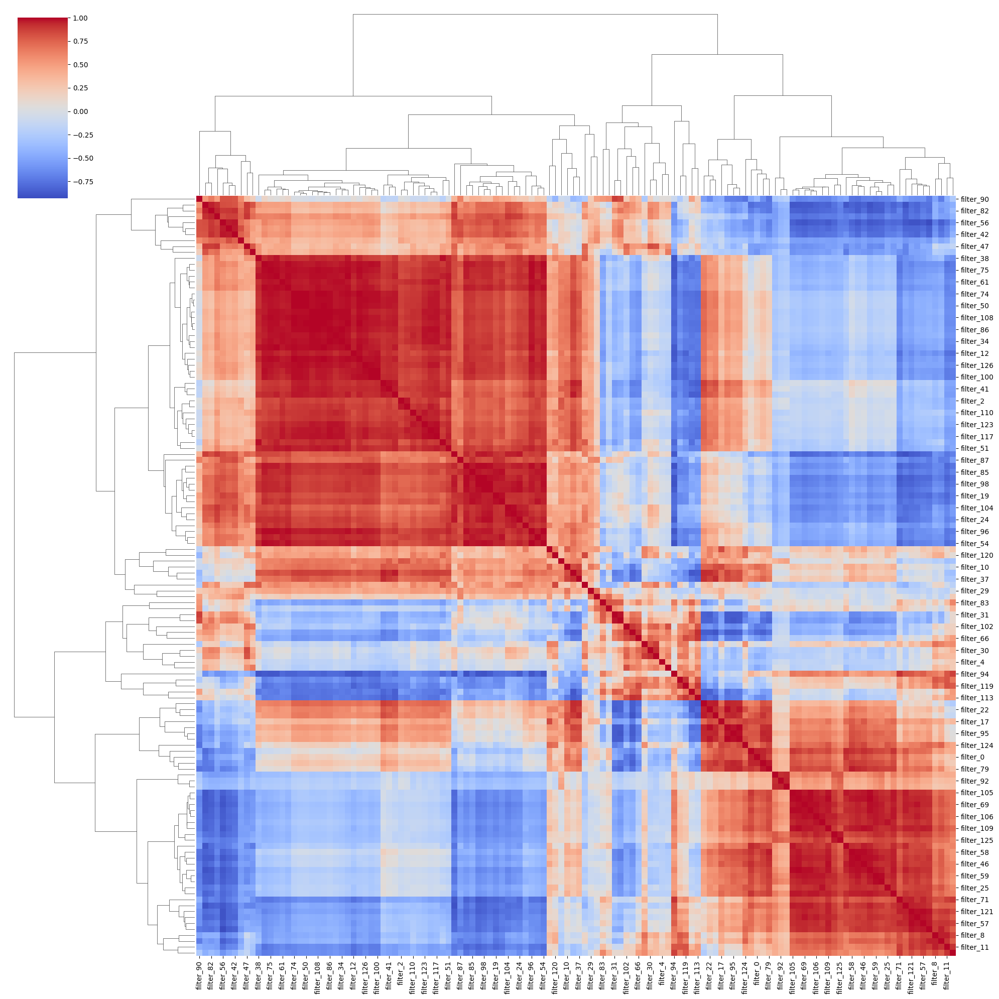

In [115]:
# clustermap of the correlation,
cluster_map = sns.clustermap(corr, cmap='coolwarm', figsize=(20,20))

In [10]:
threshold = 0.85

# Get the pairs of filters with correlation above the threshold
highly_correlated_pairs = []

for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[1]):
        if abs(corr.iloc[i, j]) > threshold:
            highly_correlated_pairs.append((corr.index[i], corr.columns[j]))

# Print the highly correlated pairs of filters
print(highly_correlated_pairs)

[('filter_0', 'filter_6'), ('filter_0', 'filter_16'), ('filter_0', 'filter_39'), ('filter_0', 'filter_79'), ('filter_1', 'filter_92'), ('filter_1', 'filter_116'), ('filter_2', 'filter_3'), ('filter_2', 'filter_9'), ('filter_2', 'filter_18'), ('filter_2', 'filter_34'), ('filter_2', 'filter_41'), ('filter_2', 'filter_43'), ('filter_2', 'filter_50'), ('filter_2', 'filter_51'), ('filter_2', 'filter_52'), ('filter_2', 'filter_53'), ('filter_2', 'filter_61'), ('filter_2', 'filter_63'), ('filter_2', 'filter_74'), ('filter_2', 'filter_86'), ('filter_2', 'filter_89'), ('filter_2', 'filter_108'), ('filter_2', 'filter_117'), ('filter_2', 'filter_122'), ('filter_2', 'filter_123'), ('filter_2', 'filter_126'), ('filter_3', 'filter_7'), ('filter_3', 'filter_9'), ('filter_3', 'filter_12'), ('filter_3', 'filter_18'), ('filter_3', 'filter_19'), ('filter_3', 'filter_24'), ('filter_3', 'filter_34'), ('filter_3', 'filter_38'), ('filter_3', 'filter_43'), ('filter_3', 'filter_49'), ('filter_3', 'filter_50'),

In [71]:
# now for each pair of interaction in highly_correlated_pairs, we want to find the common rbps and print them
rbp_interaction_list = []
for pair in highly_correlated_pairs:
    filter1 = pair[0]
    filter2 = pair[1]
    print(filter1, filter2)
    try:
        for rbp1 in filter_rbps_dict[filter1]:
            for rbp2 in filter_rbps_dict[filter2]:
                intx = f'{rbp1},{rbp2}'
                rbp_interaction_list.append(intx)
    except:
        continue


filter_0 filter_6
filter_0 filter_16
filter_0 filter_39
filter_0 filter_79
filter_1 filter_92
filter_1 filter_116
filter_2 filter_3
filter_2 filter_9
filter_2 filter_18
filter_2 filter_34
filter_2 filter_41
filter_2 filter_43
filter_2 filter_50
filter_2 filter_51
filter_2 filter_52
filter_2 filter_53
filter_2 filter_61
filter_2 filter_63
filter_2 filter_74
filter_2 filter_86
filter_2 filter_89
filter_2 filter_108
filter_2 filter_117
filter_2 filter_122
filter_2 filter_123
filter_2 filter_126
filter_3 filter_7
filter_3 filter_9
filter_3 filter_12
filter_3 filter_18
filter_3 filter_19
filter_3 filter_24
filter_3 filter_34
filter_3 filter_38
filter_3 filter_43
filter_3 filter_49
filter_3 filter_50
filter_3 filter_51
filter_3 filter_52
filter_3 filter_53
filter_3 filter_54
filter_3 filter_60
filter_3 filter_61
filter_3 filter_67
filter_3 filter_68
filter_3 filter_70
filter_3 filter_74
filter_3 filter_75
filter_3 filter_85
filter_3 filter_86
filter_3 filter_89
filter_3 filter_96
filter_3 fi

In [72]:
# sav rbp_interaction_list into a file
with open('rbp_interaction_list.txt', 'w') as f:
    for item in rbp_interaction_list:
        f.write("%s\n" % item)  

In [119]:
len(rbp_interaction_list)

154494

In [73]:
rbp_interaction_list = []
for pair in highly_correlated_pairs:
    filter1 = pair[0]
    filter2 = pair[1]
    try:
        f1_rbps = "-".join(filter_rbps_dict[filter1])
        f2_rbps = "-".join(filter_rbps_dict[filter2])
        intx = f'{f1_rbps},{f2_rbps}'
        rbp_interaction_list.append(intx)
    except:
        continue

rbp_interaction_list[0]

'SRSF7-RSF1-An_0287,CG7903-ELAV-Tb_0217-ETR-1-PAPI-BRUNOL4-BRU-3-RALY-PFI1435w-ARET-BRUNOL5-RBM38-FNE-ORB2-BRUNOL6-TIA1-HuR-SUP-12-ZC3H14-Tv_0258-UNC-75-Rbm38-SFPQ'

In [74]:
with open('rbp_interaction_list_2.txt', 'w') as f:
    for item in rbp_interaction_list:
        f.write("%s\n" % item)  

In [123]:
# write a file for for pair in highly_correlated_pairs:
with open('filter_interaction_list.txt', 'w') as f:
    for item in highly_correlated_pairs:
        out = f'{item[0]},{item[1]}'
        f.write("%s\n" % out)

In [20]:
import pandas as pd
import plotly.graph_objects as go
import json

In [75]:
rbp_filter_dict_json = json.dumps(filter_rbps_dict, indent=4)

In [16]:
correlation_matrix = corr

/Users/aidensababi/opt/anaconda3/lib/python3.9/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


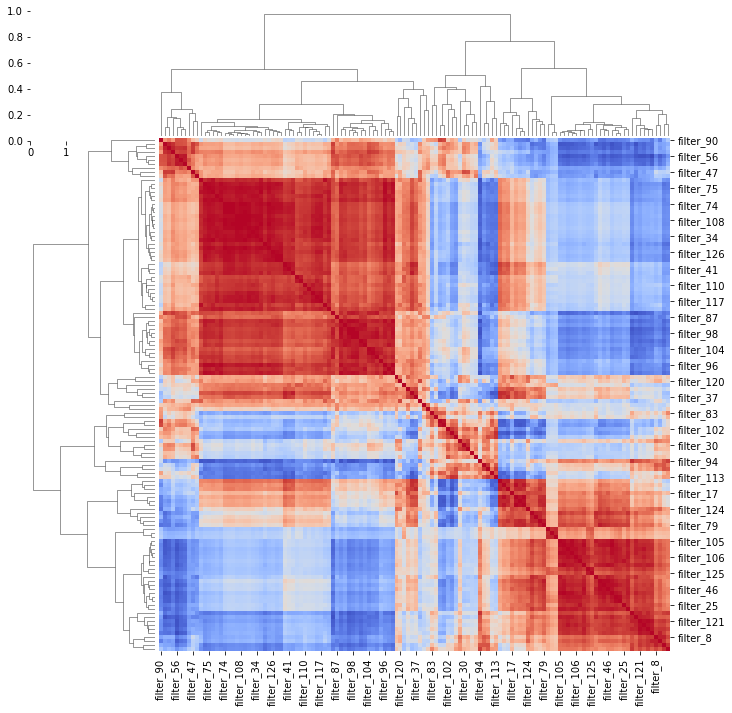

In [14]:
g = sns.clustermap(correlation_matrix, cmap="coolwarm", figsize=(10, 10), cbar=False)

# Get the row and column indices from the Seaborn clustermap
row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

# Reorder the correlation matrix based on the clustering
ordered_corr_matrix = correlation_matrix.iloc[row_order, col_order]

# Generate hover text for each cell
hover_text = []
for i in range(ordered_corr_matrix.shape[0]):
    hover_text_row = []
    for j in range(ordered_corr_matrix.shape[1]):
        filter1_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.index[i], []))
        filter2_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.columns[j], []))
        hover_text_row.append(
            f"Filter 1: {ordered_corr_matrix.index[i]}<br>"
            f"Filter 2: {ordered_corr_matrix.columns[j]}<br>"
            f"Correlation: {ordered_corr_matrix.iloc[i, j]:.2f}<br><br>"
            f"RBPs for Filter 1: {filter1_rbplist}<br>"
            f"RBPs for Filter 2: {filter2_rbplist}"
        )
    hover_text.append(hover_text_row)

fig = go.Figure(go.Heatmap(
    z=ordered_corr_matrix,
    x=ordered_corr_matrix.columns,
    y=ordered_corr_matrix.index,
    text=hover_text,
    hoverinfo='text',
    colorscale="Viridis"
))

# Set the axis labels
fig.update_layout(
    yaxis=dict(autorange="reversed"),
    width=20 * 72,  # 20 inches * 72 dots per inch
    height=20 * 72  # 20 inches * 72 dots per inch
)

fig.show()

In [82]:
import plotly.io as pio
# pio.write_html(fig, file='interactive_heatmap.html', auto_open=True)

/Users/aidensababi/opt/anaconda3/envs/exai/lib/python3.10/site-packages/seaborn/matrix.py:657: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



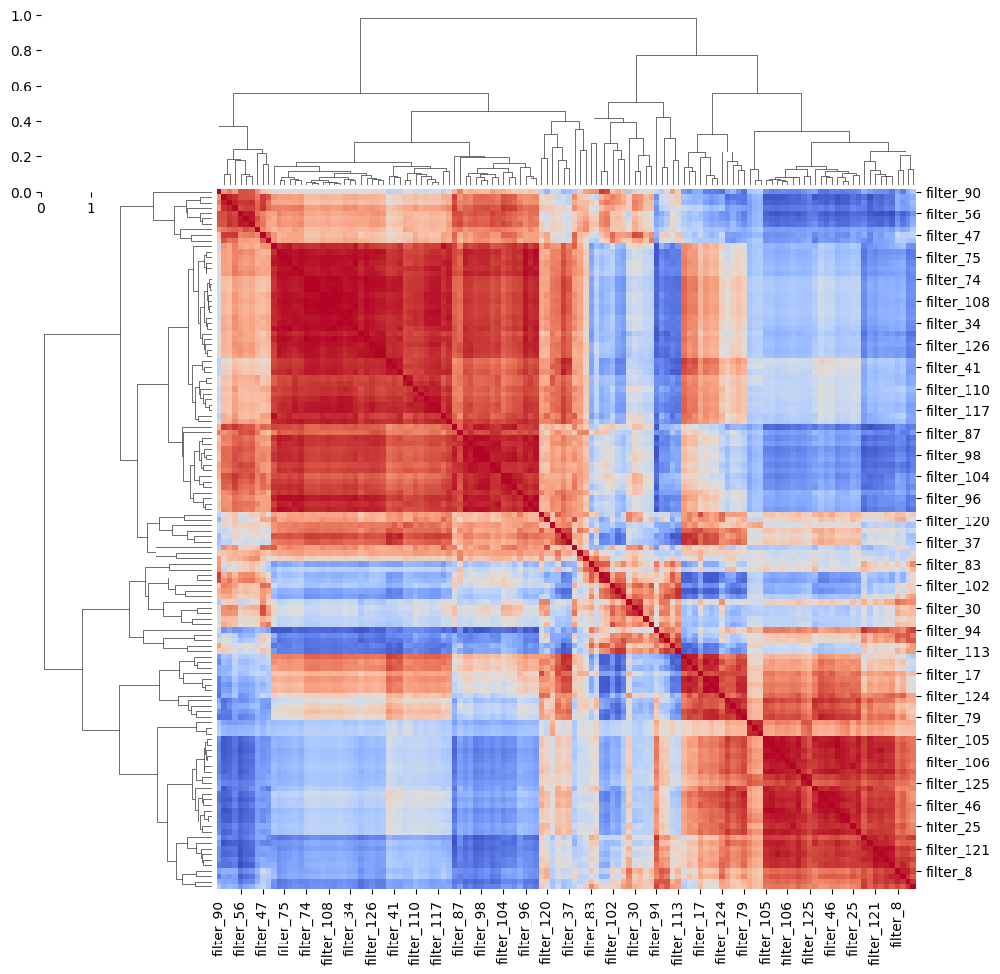

In [152]:
g = sns.clustermap(correlation_matrix, cmap="coolwarm", figsize=(10, 10), cbar=False)

# Get the row and column indices from the Seaborn clustermap
row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

# Reorder the correlation matrix based on the clustering
ordered_corr_matrix = correlation_matrix.iloc[row_order, col_order]

# Generate hover text for each cell
hover_text = []
for i in range(ordered_corr_matrix.shape[0]):
    hover_text_row = []
    for j in range(ordered_corr_matrix.shape[1]):
        filter1_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.index[i], []))
        filter2_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.columns[j], []))
        hover_text_row.append(
            f"Filter 1: {ordered_corr_matrix.index[i]}<br>"
            f"Filter 2: {ordered_corr_matrix.columns[j]}<br>"
            f"Correlation: {ordered_corr_matrix.iloc[i, j]:.2f}<br><br>"
            f"RBPs for Filter 1: {filter1_rbplist}<br>"
            f"RBPs for Filter 2: {filter2_rbplist}"
        )
    hover_text.append(hover_text_row)

fig = go.Figure(go.Heatmap(
    z=ordered_corr_matrix,
    x=ordered_corr_matrix.columns,
    y=ordered_corr_matrix.index,
    text=hover_text,
    hoverinfo='text',
    colorscale="BuPu"
))

# Set the axis labels
fig.update_layout(
    yaxis=dict(autorange="reversed"),
    width=20 * 72,  # 20 inches * 72 dots per inch
    height=20 * 72  # 20 inches * 72 dots per inch
)

fig.show()

In [153]:
pio.write_html(fig, file='interactive_heatmap_BuPu.html', auto_open=True)

In [2]:
bin_tian_rbps = ['PABPN1', 'RNAP II', 'CFII', 'PAP', 'CSTF', 'CFI',
     'PCF11', 'CPSF', 'CPSF-160','TFIID',' CPSF-30',
     'U2AF65','SYMPK','U1','U2AF','U2AF65','U2AF35','HNRNP1', 'HNRNP',
     'HNRNPH', 'HNRNPH1','HNRNPH2', 'HNRNPF', 'HNRNPFL', 'HuR', 'HuB',
     'HuD','HuC','Nova', 'Nova2','PAF','CSTF64','RBBP6','PABP2']

apa_imp = ['RBBP6', 'CSTF64', 'HuR', 'CFI25', 'CPSF5','CFI68','CPSF6','CFI59',
           'CPSF7','CFI25','CFI68','CFI59','NUDT21','PABP', 'TARDP', 'FUS']
# PABP2/PABPN1 regulates apa, and knockdown shows shortening, but no one knows how it works

# FUS binds nascent RNAs and interacts with the CPSF and CSTF complexes, and FUS knockdown leads to changes in APA


In [ ]:
filter_rbps_dict

In [13]:
for filter, rbps in filter_rbps_dict.items():
    for rbp in apa_imp:
        if rbp in rbps:
            print(filter, rbp)

filter_2 HuR
filter_4 PABP
filter_6 HuR
filter_9 HuR
filter_26 FUS
filter_27 HuR
filter_31 HuR
filter_39 HuR
filter_41 FUS
filter_42 PABP
filter_43 HuR
filter_48 HuR
filter_50 FUS
filter_68 PABP
filter_69 FUS
filter_74 HuR
filter_80 HuR
filter_84 HuR
filter_85 HuR
filter_89 FUS
filter_92 FUS
filter_95 HuR
filter_97 FUS
filter_98 HuR
filter_101 HuR
filter_102 FUS
filter_116 HuR
filter_118 PABP
filter_119 HuR
filter_122 PABP
filter_127 HuR


In [49]:
top_candidates = ['RBPFOX', 'HNRNPH2', 'HNRNPC', 'DDX5', 'NUDT21']

In [39]:
for filter, rbps in filter_rbps_dict.items():
    for rbp in bin_tian_rbps:
        if rbp in rbps:
            print(filter, rbp)

filter_2 HuR
filter_6 HuR
filter_9 HuR
filter_10 HNRNPH2
filter_21 HNRNPH2
filter_27 HuR
filter_28 PABPN1
filter_31 HuR
filter_38 HNRNPH2
filter_39 HuR
filter_40 HNRNPH2
filter_42 PABPN1
filter_43 HuR
filter_45 HNRNPH2
filter_48 HuR
filter_49 PABPN1
filter_50 HNRNPH2
filter_60 HNRNPH2
filter_74 HuR
filter_77 PABPN1
filter_80 HuR
filter_84 HuR
filter_85 HuR
filter_86 HNRNPH2
filter_87 PABPN1
filter_88 PABPN1
filter_93 PABPN1
filter_95 HuR
filter_98 HuR
filter_101 HuR
filter_110 PABPN1
filter_112 HNRNPH2
filter_115 HNRNPH2
filter_116 HuR
filter_119 HuR
filter_122 PABPN1
filter_127 HuR


In [155]:
# append all the rbps in each value of filter_rbps_dict into a list just keep the unique ones
all_rbps = []
for filter, rbps in filter_rbps_dict.items():
    all_rbps.extend(rbps)

all_rbps = list(set(all_rbps))
print(len(all_rbps))

197


In [22]:
ordered_corr_matrix

,filter_90,filter_65,filter_82,filter_23,filter_56,filter_35,filter_42,filter_36,filter_47,filter_48,...,filter_71,filter_15,filter_121,filter_64,filter_57,filter_115,filter_8,filter_118,filter_11,filter_20
filter_90,1.000000,0.526032,0.659188,0.502720,0.804327,0.805945,0.793656,0.583935,0.314054,0.202084,...,-0.428486,-0.542248,-0.605984,-0.626670,-0.606560,-0.723813,-0.513480,-0.708133,-0.447421,-0.259629
filter_65,0.526032,1.000000,0.951565,0.910986,0.820245,0.812976,0.799038,0.655726,0.882027,0.796573,...,-0.759892,-0.898245,-0.782565,-0.809856,-0.748145,-0.752384,-0.436423,-0.533388,-0.507082,-0.445418
filter_82,0.659188,0.951565,1.000000,0.944972,0.892567,0.897053,0.909668,0.726771,0.878203,0.674503,...,-0.669085,-0.846476,-0.762648,-0.806461,-0.718748,-0.770054,-0.437073,-0.577984,-0.502550,-0.362492
filter_23,0.502720,0.910986,0.944972,1.000000,0.841412,0.867144,0.868330,0.750226,0.895787,0.707892,...,-0.693282,-0.817236,-0.734280,-0.759094,-0.680419,-0.711582,-0.425078,-0.530306,-0.533661,-0.418228
filter_56,0.804327,0.820245,0.892567,0.841412,1.000000,0.959799,0.965294,0.705456,0.612022,0.481805,...,-0.792986,-0.871586,-0.897676,-0.899376,-0.866970,-0.930084,-0.713907,-0.844735,-0.755806,-0.597773
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_115,-0.723813,-0.752384,-0.770054,-0.711582,-0.930084,-0.850235,-0.829135,-0.562562,-0.450164,-0.449565,...,0.892512,0.909361,0.971479,0.960139,0.968442,1.000000,0.878943,0.950880,0.876105,0.762703
filter_8,-0.513480,-0.436423,-0.437073,-0.425078,-0.713907,-0.626388,-0.578845,-0.386237,-0.072920,-0.207671,...,0.814672,0.712727,0.856311,0.814190,0.882904,0.878943,1.000000,0.948085,0.953630,0.849991
filter_118,-0.708133,-0.533388,-0.577984,-0.530306,-0.844735,-0.765313,-0.732124,-0.488268,-0.189088,-0.238132,...,0.809721,0.761345,0.893472,0.861157,0.906035,0.950880,0.948085,1.000000,0.907885,0.769029
filter_11,-0.447421,-0.507082,-0.502550,-0.533661,-0.755806,-0.659905,-0.637961,-0.426415,-0.200704,-0.295881,...,0.873140,0.772258,0.902328,0.861345,0.905194,0.876105,0.953630,0.907885,1.000000,0.906037


In [50]:
filters = []
for f in filter_rbps_dict:
    for rbp in top_candidates:
        if rbp in filter_rbps_dict[f]:
            print(f, rbp)
            filters.append(f)

filter_2 HNRNPC
filter_10 HNRNPH2
filter_21 HNRNPH2
filter_27 HNRNPC
filter_31 HNRNPC
filter_38 HNRNPH2
filter_40 HNRNPH2
filter_45 HNRNPH2
filter_50 HNRNPH2
filter_52 HNRNPC
filter_60 HNRNPH2
filter_74 HNRNPC
filter_84 HNRNPC
filter_86 HNRNPH2
filter_101 HNRNPC
filter_112 HNRNPH2
filter_115 HNRNPH2
filter_119 HNRNPC


##
filter 2 and 

In [45]:
# get the correlation value from ordered_corr_matrix for the filters combination in filters list
corr_values = []
for i in range(ordered_corr_matrix.shape[0]):
    for j in range(ordered_corr_matrix.shape[1]):
        if ordered_corr_matrix.index[i] in filters and ordered_corr_matrix.columns[j] in filters:
            corr_values.append(ordered_corr_matrix.iloc[i, j])
corr_values


[1.0,
 0.9152303364782421,
 0.9042321166699594,
 0.9230798229118657,
 0.8651044552722292,
 0.7519637689819877,
 0.8588788771020314,
 0.9816199701692886,
 0.865254362640455,
 0.5306447797562851,
 0.7932538162974974,
 0.09845015104261343,
 -0.43001761389319343,
 -0.566329051083156,
 0.6060561567016988,
 0.460814517354377,
 0.3792994462469618,
 -0.4327933842529307,
 0.9152303364782421,
 1.0,
 0.9948979577600048,
 0.9881955661949446,
 0.9810893049166731,
 0.8598879986095642,
 0.9619727830915952,
 0.9100525559578252,
 0.8574710571008513,
 0.6887561726320831,
 0.8702932379685313,
 0.17128075302547052,
 -0.4297543934756091,
 -0.7683401728858935,
 0.7393618833492981,
 0.6517913995716677,
 0.480185804186508,
 -0.44613937556767297,
 0.9042321166699594,
 0.9948979577600048,
 1.0,
 0.9881722835689192,
 0.9731609256214713,
 0.8693239873567222,
 0.9676148685723407,
 0.9040039368032032,
 0.8395184019652927,
 0.6982370174178303,
 0.8698111994565596,
 0.17478163402972868,
 -0.4372738976971225,
 -0.7455

In [46]:
corr_values

[1.0,
 0.9152303364782421,
 0.9042321166699594,
 0.9230798229118657,
 0.8651044552722292,
 0.7519637689819877,
 0.8588788771020314,
 0.9816199701692886,
 0.865254362640455,
 0.5306447797562851,
 0.7932538162974974,
 0.09845015104261343,
 -0.43001761389319343,
 -0.566329051083156,
 0.6060561567016988,
 0.460814517354377,
 0.3792994462469618,
 -0.4327933842529307,
 0.9152303364782421,
 1.0,
 0.9948979577600048,
 0.9881955661949446,
 0.9810893049166731,
 0.8598879986095642,
 0.9619727830915952,
 0.9100525559578252,
 0.8574710571008513,
 0.6887561726320831,
 0.8702932379685313,
 0.17128075302547052,
 -0.4297543934756091,
 -0.7683401728858935,
 0.7393618833492981,
 0.6517913995716677,
 0.480185804186508,
 -0.44613937556767297,
 0.9042321166699594,
 0.9948979577600048,
 1.0,
 0.9881722835689192,
 0.9731609256214713,
 0.8693239873567222,
 0.9676148685723407,
 0.9040039368032032,
 0.8395184019652927,
 0.6982370174178303,
 0.8698111994565596,
 0.17478163402972868,
 -0.4372738976971225,
 -0.7455

In [137]:
# write all_rbps to a file
with open('all_rbp_hits.txt', 'w') as f:
    for rbp in all_rbps:
        f.write(rbp + '\n')

In [61]:
# Create an empty dissimilarity matrix
num_cts = len(main_cts)
dissimilarity_matrix = np.zeros((num_cts, num_cts))

# Compute the Frobenius norm for the difference between each pair of correlation matrices
for i, ct1 in enumerate(main_cts):
    for j, ct2 in enumerate(main_cts):
        if i < j:
            diff = correlation_matrices[ct1] - correlation_matrices[ct2]
            frobenius_norm = np.linalg.norm(diff, 'fro')
            dissimilarity_matrix[i, j] = frobenius_norm
            dissimilarity_matrix[j, i] = frobenius_norm  # The matrix is symmetric
# lets scale the dissimilarity_matrix so the heatmap would be nicer

dissimilarity_matrix = dissimilarity_matrix / np.max(dissimilarity_matrix)

NameError: name 'main_cts' is not defined

## Lets read the filter filter similarity and ignore the filter correlations that their sequence are highly similar (align)

In [22]:
ff_df = pd.read_csv('motif_similarity.tsv', sep='\t')
ff_df = ff_df[ff_df['q-value'] < 0.05]
ff_df.head()

,Query_ID,Target_ID,Optimal_offset,p-value,E-value,q-value,Overlap,Query_consensus,Target_consensus,Orientation
0,filter_0,filter_0,0,5.177890e-18,6.627690e-16,6.608960e-16,8,UGACUACU,UGACUACU,+
8,filter_1,filter_1,0,1.034730e-10,1.324450e-08,1.276900e-08,8,CGCGGCGG,CGCGGCGG,+
21,filter_2,filter_2,0,2.393900e-07,3.064190e-05,9.542700e-06,8,UUUAUUUU,UUUAUUUU,+
22,filter_2,filter_74,0,2.393900e-07,3.064190e-05,9.542700e-06,8,UUUAUUUU,UUUAUUUU,+
23,filter_2,filter_84,0,2.393900e-07,3.064190e-05,9.542700e-06,8,UUUAUUUU,UUUAUUUU,+


In [24]:
# if Query_ID and Target_ID is same remove it from ff_df
ff_df = ff_df[ff_df['Query_ID'] != ff_df['Target_ID']]
print(ff_df.shape)
ff_df

(60, 10)


,Query_ID,Target_ID,Optimal_offset,p-value,E-value,q-value,Overlap,Query_consensus,Target_consensus,Orientation
22,filter_2,filter_74,0,2.393900e-07,0.000031,0.000010,8,UUUAUUUU,UUUAUUUU,+
23,filter_2,filter_84,0,2.393900e-07,0.000031,0.000010,8,UUUAUUUU,UUUAUUUU,+
24,filter_2,filter_119,-1,1.385770e-03,0.177379,0.041430,7,UUUAUUUU,UUUUUUAA,+
25,filter_2,filter_27,0,1.983880e-03,0.253937,0.047449,8,UUUAUUUU,UGAAUUUU,+
250,filter_21,filter_115,-1,3.745040e-07,0.000048,0.000023,7,AGGGGGGG,GGGGGGGA,+
295,filter_26,filter_76,1,5.454350e-04,0.069816,0.033654,7,GAGUCCCA,AGCAUCCC,+
308,filter_27,filter_2,0,1.318590e-03,0.168780,0.039111,8,UGAAUUUU,UUUAUUUU,+
309,filter_27,filter_74,0,1.318590e-03,0.168780,0.039111,8,UGAAUUUU,UUUAUUUU,+
310,filter_27,filter_84,0,1.318590e-03,0.168780,0.039111,8,UGAAUUUU,UUUAUUUU,+
311,filter_27,filter_85,0,1.881740e-03,0.240862,0.044651,8,UGAAUUUU,UGAUUUUA,+


In [25]:
correlation_matrix

,filter_0,filter_1,filter_2,filter_3,filter_4,filter_5,filter_6,filter_7,filter_8,filter_9,...,filter_118,filter_119,filter_120,filter_121,filter_122,filter_123,filter_124,filter_125,filter_126,filter_127
filter_0,1.000000,0.413949,0.241220,-0.018883,-0.349060,-0.255493,0.896321,-0.183859,0.281864,0.189422,...,0.333788,-0.290851,0.160431,0.538405,0.160986,0.253224,0.673633,0.547614,0.181311,0.082308
filter_1,0.413949,1.000000,-0.074063,-0.391201,-0.109471,-0.302785,0.534771,-0.499376,0.379108,-0.273318,...,0.412290,0.134071,-0.114882,0.571113,-0.294847,-0.227708,0.272660,0.795805,-0.289574,-0.350687
filter_2,0.241220,-0.074063,1.000000,0.859534,-0.135447,0.388860,-0.099157,0.680654,-0.380821,0.851595,...,-0.345849,-0.638313,0.392445,-0.369241,0.853411,0.851941,0.193562,-0.154984,0.873910,0.821646
filter_3,-0.018883,-0.391201,0.859534,1.000000,-0.069793,0.470665,-0.415877,0.882928,-0.590056,0.904269,...,-0.601334,-0.672379,0.351282,-0.680932,0.912972,0.866473,-0.059945,-0.473984,0.940721,0.926506
filter_4,-0.349060,-0.109471,-0.135447,-0.069793,1.000000,0.203968,-0.238024,0.077439,0.190312,-0.174254,...,0.105685,0.451187,0.043673,-0.019831,-0.167442,-0.166194,-0.071333,-0.121766,-0.170132,-0.116547
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_123,0.253224,-0.227708,0.851941,0.866473,-0.166194,0.572497,-0.108503,0.748470,-0.320409,0.950251,...,-0.272388,-0.639010,0.603285,-0.369677,0.968090,1.000000,0.308091,-0.202889,0.929598,0.916024
filter_124,0.673633,0.272660,0.193562,-0.059945,-0.071333,0.384863,0.693114,-0.024586,0.669963,0.211021,...,0.755708,0.094215,0.698296,0.638877,0.218179,0.308091,1.000000,0.568082,0.103373,0.160735
filter_125,0.547614,0.795805,-0.154984,-0.473984,-0.121766,-0.185008,0.720508,-0.552631,0.678124,-0.295418,...,0.703195,0.261478,0.138039,0.798316,-0.302444,-0.202889,0.568082,1.000000,-0.335209,-0.380767
filter_126,0.181311,-0.289574,0.873910,0.940721,-0.170132,0.460079,-0.236032,0.820930,-0.506415,0.971650,...,-0.494455,-0.728568,0.421437,-0.562227,0.965640,0.929598,0.103373,-0.335209,1.000000,0.956826


In [26]:
# lets zero the correlation for Qeuery_ID and Target_ID for correlation_matrix
for index, row in ff_df.iterrows():
    correlation_matrix.loc[row['Query_ID'], row['Target_ID']] = 0
    correlation_matrix.loc[row['Target_ID'], row['Query_ID']] = 0
correlation_matrix

,filter_0,filter_1,filter_2,filter_3,filter_4,filter_5,filter_6,filter_7,filter_8,filter_9,...,filter_118,filter_119,filter_120,filter_121,filter_122,filter_123,filter_124,filter_125,filter_126,filter_127
filter_0,1.000000,0.413949,0.241220,-0.018883,-0.349060,-0.255493,0.896321,-0.183859,0.281864,0.189422,...,0.333788,-0.290851,0.160431,0.538405,0.160986,0.253224,0.673633,0.547614,0.181311,0.082308
filter_1,0.413949,1.000000,-0.074063,-0.391201,-0.109471,-0.302785,0.534771,-0.499376,0.379108,-0.273318,...,0.412290,0.134071,-0.114882,0.571113,-0.294847,-0.227708,0.272660,0.795805,-0.289574,-0.350687
filter_2,0.241220,-0.074063,1.000000,0.859534,-0.135447,0.388860,-0.099157,0.680654,-0.380821,0.851595,...,-0.345849,0.000000,0.392445,-0.369241,0.853411,0.851941,0.193562,-0.154984,0.873910,0.821646
filter_3,-0.018883,-0.391201,0.859534,1.000000,-0.069793,0.470665,-0.415877,0.882928,-0.590056,0.904269,...,-0.601334,-0.672379,0.351282,-0.680932,0.912972,0.866473,-0.059945,-0.473984,0.940721,0.926506
filter_4,-0.349060,-0.109471,-0.135447,-0.069793,1.000000,0.203968,-0.238024,0.077439,0.190312,-0.174254,...,0.105685,0.451187,0.043673,-0.019831,-0.167442,-0.166194,-0.071333,-0.121766,-0.170132,-0.116547
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_123,0.253224,-0.227708,0.851941,0.866473,-0.166194,0.572497,-0.108503,0.748470,-0.320409,0.950251,...,-0.272388,-0.639010,0.603285,-0.369677,0.968090,1.000000,0.308091,-0.202889,0.929598,0.916024
filter_124,0.673633,0.272660,0.193562,-0.059945,-0.071333,0.384863,0.693114,-0.024586,0.669963,0.211021,...,0.000000,0.094215,0.698296,0.638877,0.218179,0.308091,1.000000,0.568082,0.103373,0.160735
filter_125,0.547614,0.795805,-0.154984,-0.473984,-0.121766,-0.185008,0.720508,-0.552631,0.678124,-0.295418,...,0.703195,0.261478,0.138039,0.798316,-0.302444,-0.202889,0.568082,1.000000,-0.335209,-0.380767
filter_126,0.181311,-0.289574,0.873910,0.940721,-0.170132,0.460079,-0.236032,0.820930,-0.506415,0.971650,...,-0.494455,-0.728568,0.421437,-0.562227,0.965640,0.929598,0.103373,-0.335209,1.000000,0.956826


In [17]:
beforecorrection  = ['HNRPLL', 'HUR', 'HNRNPA1','BRUNOL6', 'Nab2p','BRUNOL4', 'BRUNOL5']
corrected_names = ['HNRNPLL', 'ELAVL1', 'HNRNPA1','CELF6', 'NAB2', 'CELF4', 'CELF5']

In [18]:
# lets change the filter_rbps_dict values to corrected names,
for key, value in filter_rbps_dict.items():
    for i, rbp in enumerate(value):
        if rbp in beforecorrection:
            value[i] = corrected_names[beforecorrection.index(rbp)]


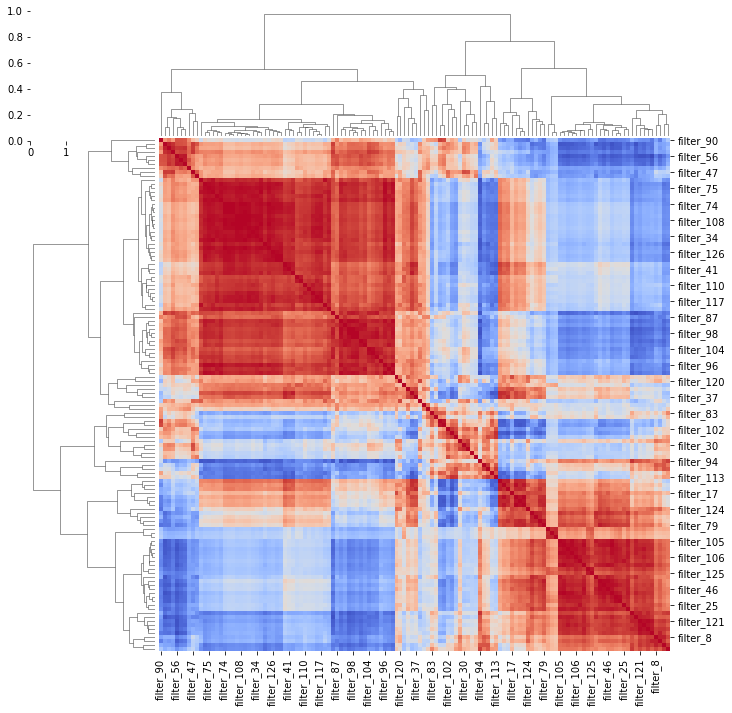

In [21]:
g = sns.clustermap(correlation_matrix, cmap="coolwarm", figsize=(10, 10), cbar=False)

# Get the row and column indices from the Seaborn clustermap
row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

# Reorder the correlation matrix based on the clustering
ordered_corr_matrix = correlation_matrix.iloc[row_order, col_order]

# Generate hover text for each cell
hover_text = []
for i in range(ordered_corr_matrix.shape[0]):
    hover_text_row = []
    for j in range(ordered_corr_matrix.shape[1]):
        filter1_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.index[i], []))
        filter2_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.columns[j], []))
        hover_text_row.append(
            f"Filter 1: {ordered_corr_matrix.index[i]}<br>"
            f"Filter 2: {ordered_corr_matrix.columns[j]}<br>"
            f"Correlation: {ordered_corr_matrix.iloc[i, j]:.2f}<br><br>"
            f"RBPs for Filter 1: {filter1_rbplist}<br>"
            f"RBPs for Filter 2: {filter2_rbplist}"
        )
    hover_text.append(hover_text_row)

fig = go.Figure(go.Heatmap(
    z=ordered_corr_matrix,
    x=ordered_corr_matrix.columns,
    y=ordered_corr_matrix.index,
    text=hover_text,
    hoverinfo='text',
    colorscale="BuPu"
))

# Set the axis labels
fig.update_layout(
    yaxis=dict(autorange="reversed"),
    width=20 * 72,  # 20 inches * 72 dots per inch
    height=20 * 72  # 20 inches * 72 dots per inch
)

fig.show()

/Users/aidensababi/opt/anaconda3/lib/python3.9/site-packages/seaborn/matrix.py:654: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



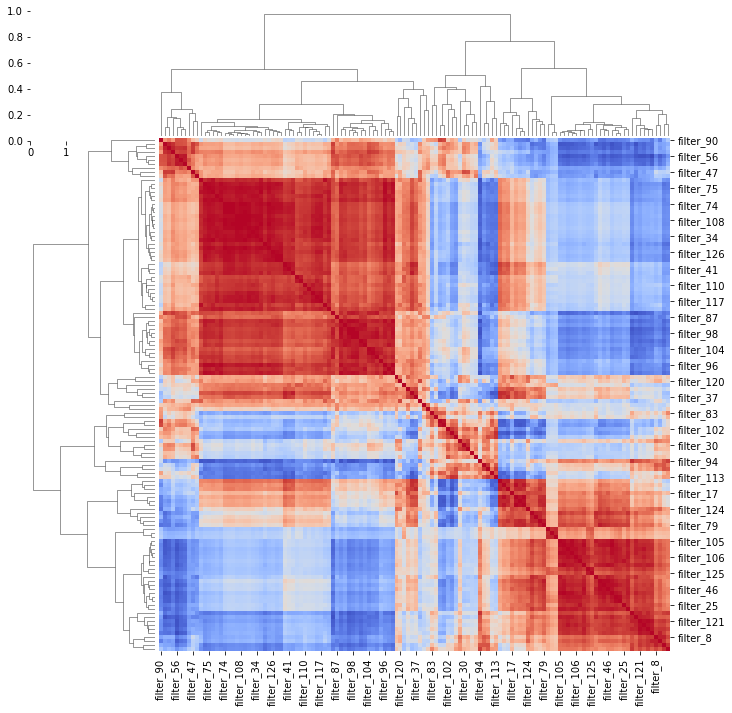

In [80]:
g = sns.clustermap(correlation_matrix, cmap="coolwarm", figsize=(10, 10), cbar=False)

# Get the row and column indices from the Seaborn clustermap
row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

# Reorder the correlation matrix based on the clustering
ordered_corr_matrix = correlation_matrix.iloc[row_order, col_order]

# Generate hover text for each cell
hover_text = []
for i in range(ordered_corr_matrix.shape[0]):
    hover_text_row = []
    for j in range(ordered_corr_matrix.shape[1]):
        filter1_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.index[i], []))
        filter2_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.columns[j], []))
        hover_text_row.append(
            f"Filter 1: {ordered_corr_matrix.index[i]}<br>"
            f"Filter 2: {ordered_corr_matrix.columns[j]}<br>"
            f"Correlation: {ordered_corr_matrix.iloc[i, j]:.2f}<br><br>"
            f"RBPs for Filter 1: {filter1_rbplist}<br>"
            f"RBPs for Filter 2: {filter2_rbplist}"
        )
    hover_text.append(hover_text_row)

fig = go.Figure(go.Heatmap(
    z=ordered_corr_matrix,
    x=ordered_corr_matrix.columns,
    y=ordered_corr_matrix.index,
    text=hover_text,
    hoverinfo='text',
    colorscale="BuPu"
))

# Set the axis labels
fig.update_layout(
    yaxis=dict(autorange="reversed"),
    width=20 * 72,  # 20 inches * 72 dots per inch
    height=20 * 72  # 20 inches * 72 dots per inch
)

fig.show()

In [83]:
pio.write_html(fig, file='25_08_interactive_heatmap_BuPu.html', auto_open=True)

In [56]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

rbp_dict = filter_rbps_dict.copy()
def jaccard_similarity(list1, list2):
    set1, set2 = set(list1), set(list2)
    intersection = len(set1 & set2)
    union = len(set1) + len(set2) - intersection
    return intersection / union

# To keep track of filters that are similar
to_remove = set()
threshold = 0.25  # Adjust this as needed

for filter1, rbp1 in rbp_dict.items():
    for filter2, rbp2 in rbp_dict.items():
        if filter1 != filter2 and filter1 not in to_remove and filter2 not in to_remove:
            if jaccard_similarity(rbp1, rbp2) >= threshold:
                to_remove.add(filter2)

# Remove similar filters
for filter in to_remove:
    del rbp_dict[filter]

print(rbp_dict)

{'filter_0': ['RSF1', 'SRSF7', 'An_0287'], 'filter_1': ['CG33714', 'RBM4', 'ZC3H10', 'PPRC1', 'LIN28A', 'SRSF1', 'LARK', 'B52', 'SRSF7'], 'filter_2': ['Tb_0220', 'ARET', 'ZC3H14', 'CELF4', 'HNRNPCL1', 'RBP9', 'Ot_0262', 'TIA1', 'CPEB2', 'HuR', 'CPEB4', 'FNE', 'Pp_0229', 'Smp_067420', 'EXC-7', 'RALY', 'Tv_0258', 'SXL', 'Tv_0236', 'PAPI', 'U2AF2', 'TIAR-1', 'PFI1435w', 'Tb_0217', 'HNRNPC', 'ELAV', 'CELF5', 'U2AF50', 'ETR-1', 'PTBP1', 'Pp_0228', 'TIAR-3'], 'filter_3': ['RBM45', 'PUM', 'YBX1', 'Pp_0206', 'MAL8P1.40', 'PF13_0315', 'Sf3b4', 'An_0265'], 'filter_4': ['PABP', 'RBMS1', 'MAL13P1.35', 'Rbm42', 'Tb_0219', 'IGF2BP2', 'IGF2BP3', 'Tb_0251', 'RBM41', 'TUT1'], 'filter_7': ['NCU02404', 'RBM47', 'RO3G_00049', 'Rbm47', 'LIN28A', 'SUP-12', 'CG7804'], 'filter_8': ['ASD-1', 'HNRNPL', 'QKR58E-1', 'MEX-5', 'YBX1', 'NCU08034', 'A1CF', 'CNOT4', 'SHEP', 'Tb_0216', 'PF13_0315', 'Lm_0212', 'An_0265'], 'filter_11': ['MEX-5', 'YBX1', 'Pp_0206', 'PTBP1', 'SHEP', 'IGF2BP3', 'Pcbp2'], 'filter_13': ['PCBP

In [57]:
len(rbp_dict)

65

In [59]:
# keep the filters that are in rbp_dict, from correlation_matrix
correlation_matrix = correlation_matrix.loc[list(rbp_dict.keys()), list(rbp_dict.keys())]
correlation_matrix

,filter_0,filter_1,filter_2,filter_3,filter_4,filter_7,filter_8,filter_11,filter_13,filter_14,...,filter_96,filter_99,filter_100,filter_102,filter_105,filter_112,filter_113,filter_117,filter_120,filter_121
filter_0,1.000000,0.413949,0.241220,-0.018883,-0.349060,-0.183859,0.281864,0.223631,-0.032638,0.273951,...,0.009164,0.796812,0.201120,-0.726306,0.802692,0.786739,-0.628255,0.282387,0.160431,0.538405
filter_1,0.413949,1.000000,-0.074063,-0.391201,-0.109471,-0.499376,0.379108,0.435317,-0.071732,0.377040,...,-0.393004,0.592122,-0.266636,-0.187007,0.582617,0.265756,0.034320,-0.228361,-0.114882,0.571113
filter_2,0.241220,-0.074063,1.000000,0.859534,-0.135447,0.680654,-0.380821,-0.507277,-0.123042,0.802385,...,0.823987,-0.129015,0.830421,-0.273352,-0.173599,0.430093,-0.669444,0.895349,0.392445,-0.369241
filter_3,-0.018883,-0.391201,0.859534,1.000000,-0.069793,0.882928,-0.590056,-0.727027,-0.163495,0.595258,...,0.961310,-0.463688,0.904063,-0.113967,-0.492275,0.190975,-0.600515,0.893787,0.351282,-0.680932
filter_4,-0.349060,-0.109471,-0.135447,-0.069793,1.000000,0.077439,0.190312,0.206047,0.334476,-0.112719,...,-0.104971,-0.200905,-0.208830,0.574828,-0.184402,-0.293842,0.460557,-0.184996,0.043673,-0.019831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
filter_112,0.786739,0.265756,0.430093,0.190975,-0.293842,0.038633,0.281814,0.132876,0.082573,0.423724,...,0.283257,0.693122,0.406471,-0.609263,0.631689,1.000000,-0.705323,0.531197,0.545008,0.414547
filter_113,-0.628255,0.034320,-0.669444,-0.600515,0.460557,-0.371012,0.395784,0.516555,0.391003,-0.511416,...,-0.651325,-0.206726,-0.776913,0.804386,-0.155699,-0.705323,1.000000,-0.758132,-0.211924,0.188383
filter_117,0.282387,-0.228361,0.895349,0.893787,-0.184996,0.756459,-0.370303,-0.535896,-0.087591,0.689324,...,0.914690,-0.128129,0.919919,-0.313172,-0.172093,0.531197,-0.758132,1.000000,0.538106,-0.400683
filter_120,0.160431,-0.114882,0.392445,0.351282,0.043673,0.471014,0.410697,0.166357,0.622658,0.302379,...,0.443704,0.142538,0.337289,0.116045,0.112773,0.545008,-0.211924,0.538106,1.000000,0.109408


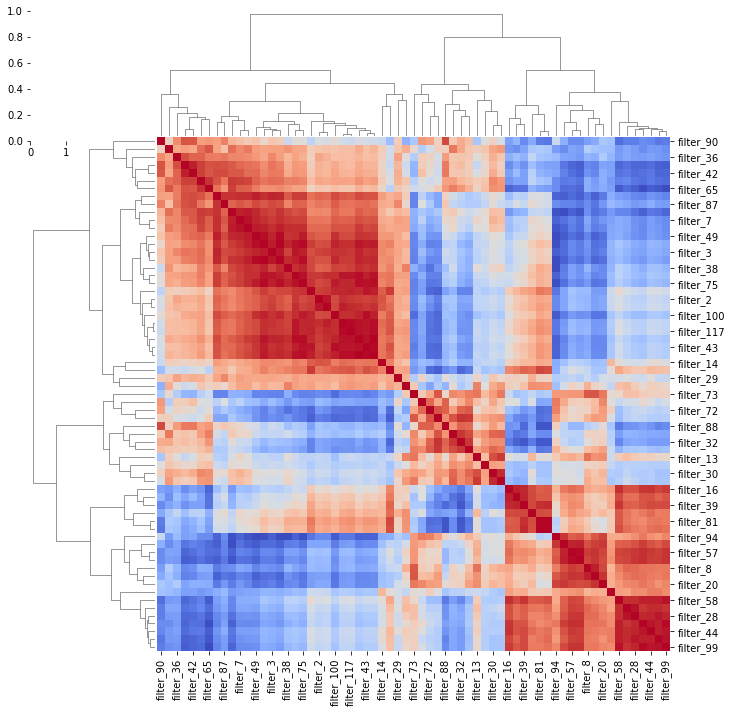

In [60]:
g = sns.clustermap(correlation_matrix, cmap="coolwarm", figsize=(10, 10), cbar=False)

# Get the row and column indices from the Seaborn clustermap
row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

# Reorder the correlation matrix based on the clustering
ordered_corr_matrix = correlation_matrix.iloc[row_order, col_order]

# Generate hover text for each cell
hover_text = []
for i in range(ordered_corr_matrix.shape[0]):
    hover_text_row = []
    for j in range(ordered_corr_matrix.shape[1]):
        filter1_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.index[i], []))
        filter2_rbplist = ', '.join(filter_rbps_dict.get(ordered_corr_matrix.columns[j], []))
        hover_text_row.append(
            f"Filter 1: {ordered_corr_matrix.index[i]}<br>"
            f"Filter 2: {ordered_corr_matrix.columns[j]}<br>"
            f"Correlation: {ordered_corr_matrix.iloc[i, j]:.2f}<br><br>"
            f"RBPs for Filter 1: {filter1_rbplist}<br>"
            f"RBPs for Filter 2: {filter2_rbplist}"
        )
    hover_text.append(hover_text_row)

fig = go.Figure(go.Heatmap(
    z=ordered_corr_matrix,
    x=ordered_corr_matrix.columns,
    y=ordered_corr_matrix.index,
    text=hover_text,
    hoverinfo='text',
    colorscale="BuPu"
))

# Set the axis labels
fig.update_layout(
    yaxis=dict(autorange="reversed"),
    width=20 * 72,  # 20 inches * 72 dots per inch
    height=20 * 72  # 20 inches * 72 dots per inch
)

fig.show()